## import libarary

In [82]:
import numpy as np
import cv2
import tensorflow as tf
from sklearn.metrics import accuracy_score, confusion_matrix
from tensorflow.keras import datasets
import tensorflow_datasets as tfds
import matplotlib.pyplot as plot

from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

##  Load the Caltech101 dataset


In [47]:
# Load the Caltech101 dataset
dataset, info = tfds.load('caltech101', with_info=True, as_supervised=True)

# Split the dataset into training and testing
train_data = dataset['train']
test_data = dataset['test']

## Convert train and test data into numpy arrays


In [49]:
def process_data(data, image_size=(128, 128)):
    images = []
    labels = []

    for image, label in data:
        # Resize image to the desired shape
        image_resized = cv2.resize(image.numpy(), image_size)
        images.append(image_resized)
        labels.append(label.numpy())
    
    return np.array(images), np.array(labels)

## Load and preprocess training and testing data


In [51]:
X_train, y_train = process_data(train_data)
X_test, y_test = process_data(test_data)

In [52]:
X_train.shape

(3059, 128, 128, 3)

## Convert images to grayscale


In [54]:
X_train_gray = np.array([cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) for img in X_train])
X_test_gray = np.array([cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) for img in X_test])


In [55]:
X_train_gray.shape

(3059, 128, 128)

## Define HOG descriptor parameters

In [57]:
winSize = (64,64)
blockSize = (16,16)
blockStride = (8,8)
cellSize = (8,8)
nbins = 9

## Initialize the HOG descriptor

In [59]:
hog = cv2.HOGDescriptor(winSize,blockSize,blockStride,cellSize,nbins)

## Extract HOG features from the training data


In [61]:
hog_features_train = [hog.compute(image).flatten() for image in X_train_gray]
hog_features_test = [hog.compute(image).flatten() for image in X_test_gray]

## Convert the list of features into numpy arrays

In [63]:
hog_features_xtrain = np.array(hog_features_train)
hog_features_test = np.array(hog_features_test)

In [64]:
import numpy as np
import matplotlib.pyplot as plt

def euclidean_distance(x1, x2):
    return np.sqrt(np.sum((x1-x2)**2))

class KMeans:

    def __init__(self, K=5, max_iters=100, plot_steps=False):
        self.K = K
        self.max_iters = max_iters
        self.plot_steps = plot_steps

        # list of sample indices for each cluster
        self.clusters = [[] for _ in range(self.K)]

        # the centers (mean vector) for each cluster
        self.centroids = []


    def predict(self, X):
        self.X = X
        self.n_samples, self.n_features = X.shape

        # initialize
        random_sample_idxs = np.random.choice(self.n_samples, self.K, replace=False)
        self.centroids = [self.X[idx] for idx in random_sample_idxs]

        # optimize clusters
        for _ in range(self.max_iters):
            # assign samples to closest centroids (create clusters)
            self.clusters = self._create_clusters(self.centroids)

            if self.plot_steps:
                self.plot()

            # calculate new centroids from the clusters
            centroids_old = self.centroids
            self.centroids = self._get_centroids(self.clusters)

            if self._is_converged(centroids_old, self.centroids):
                break

            if self.plot_steps:
                self.plot()

        # classify samples as the index of their clusters
        return self._get_cluster_labels(self.clusters)


    def _get_cluster_labels(self, clusters):
        # each sample will get the label of the cluster it was assigned to
        labels = np.empty(self.n_samples)
        for cluster_idx, cluster in enumerate(clusters):
            for sample_idx in cluster:
                labels[sample_idx] = cluster_idx

        return labels


    def _create_clusters(self, centroids):
        # assign the samples to the closest centroids
        clusters = [[] for _ in range(self.K)]
        for idx, sample in enumerate(self.X):
            centroid_idx = self._closest_centroid(sample, centroids)
            clusters[centroid_idx].append(idx)
        return clusters

    def _closest_centroid(self, sample, centroids):
        # distance of the current sample to each centroid
        distances = [euclidean_distance(sample, point) for point in centroids]
        closest_idx = np.argmin(distances)
        return closest_idx


    def _get_centroids(self, clusters):
        # assign mean value of clusters to centroids
        centroids = np.zeros((self.K, self.n_features))
        for cluster_idx, cluster in enumerate(clusters):
            cluster_mean = np.mean(self.X[cluster], axis=0)
            centroids[cluster_idx] = cluster_mean
        return centroids

    def _is_converged(self, centroids_old, centroids):
        # distances between old and new centroids, for all centroids
        distances = [euclidean_distance(centroids_old[i], centroids[i]) for i in range(self.K)]
        return sum(distances) == 0

    def plot(self):
        # Visualize the clusters in 2D space using PCA
        self.plot_clusters_2D()

    # Modify the original plot method to call plot_clusters_2D
    def plot_clusters_2D(self):
        # Use PCA to reduce dimensions to 2 for visualization
        pca = PCA(n_components=2)
        reduced_data = pca.fit_transform(self.X)  # Reduce X to 2D

        fig, ax = plt.subplots(figsize=(12, 8))

        # Plot each cluster
        for i, cluster in enumerate(self.clusters):
            points = reduced_data[cluster]
            ax.scatter(points[:, 0], points[:, 1], label=f"Cluster {i}")

        # Plot the centroids
        for point in self.centroids:
            reduced_point = pca.transform([point])  # Transform centroid to 2D
            ax.scatter(reduced_point[0, 0], reduced_point[0, 1], marker="x", color="black", linewidth=2, s=100)

        ax.legend()
        plt.show()



## Training the kMean model on the Training set


In [66]:
clusters = len(np.unique(y_train.flatten()))
classifier = KMeans(K=clusters, max_iters=20, plot_steps=True)


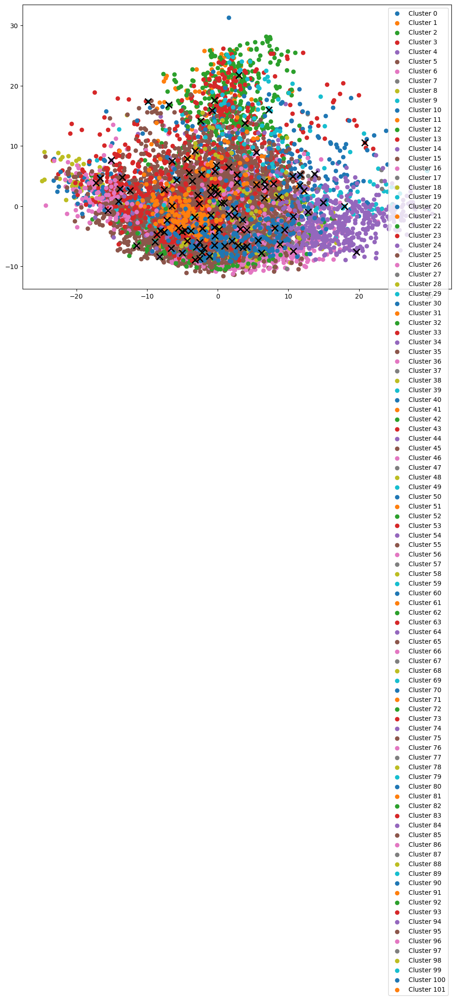

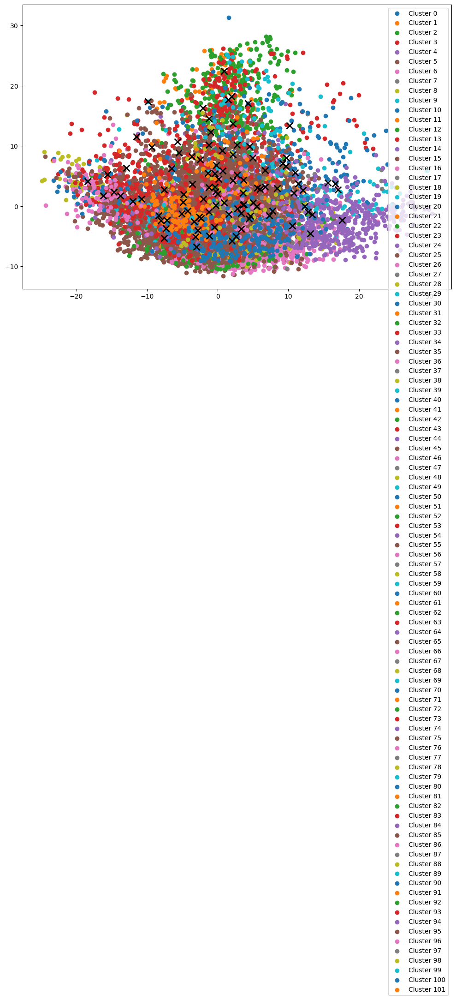

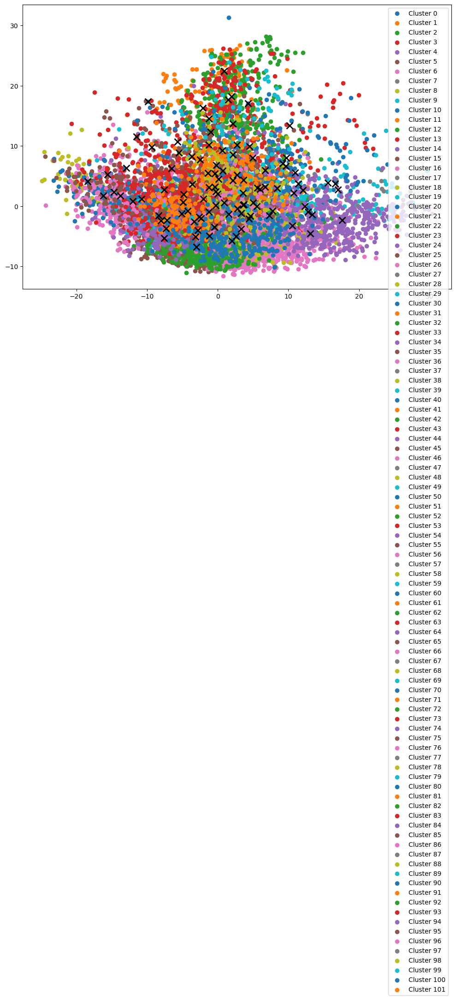

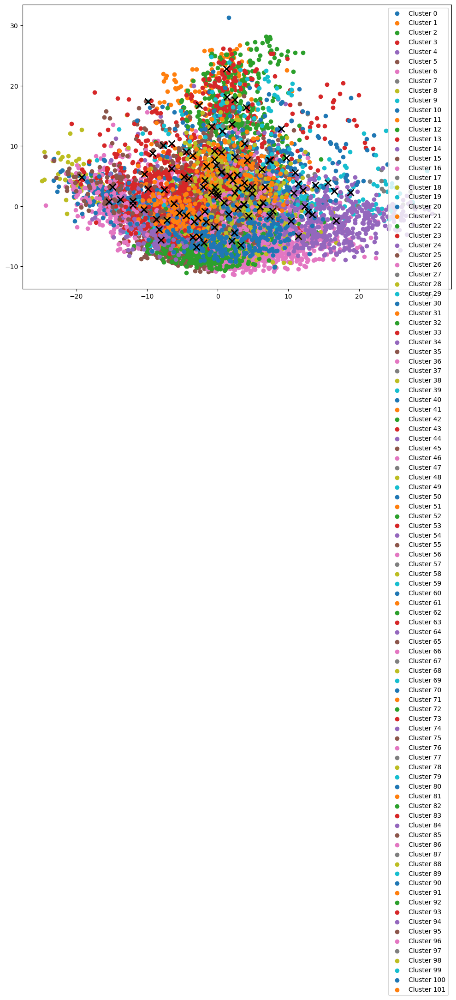

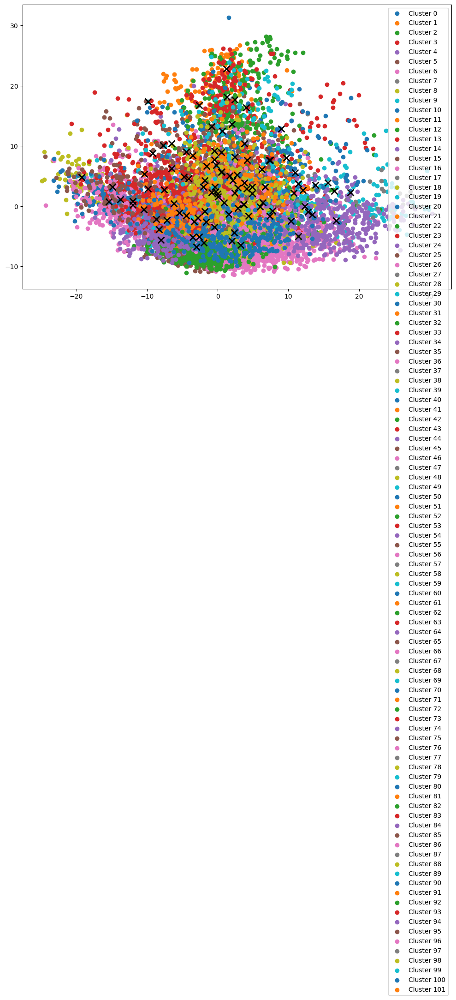

...

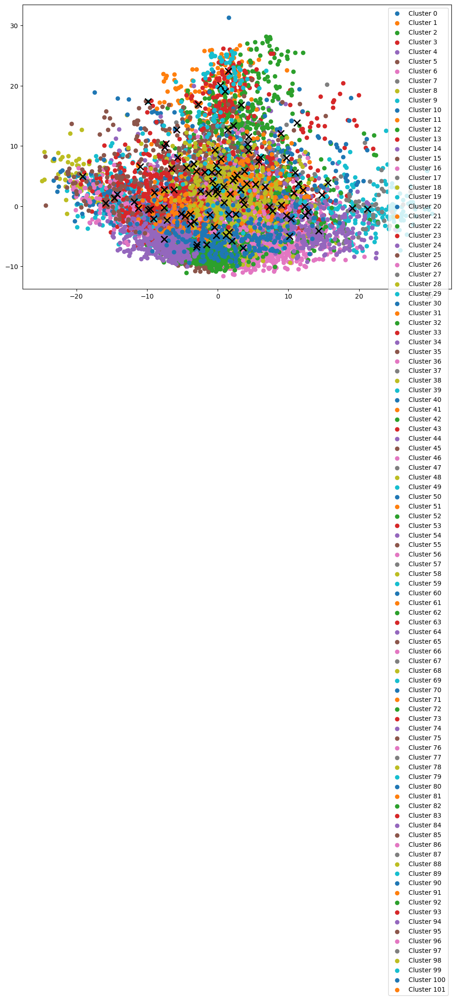

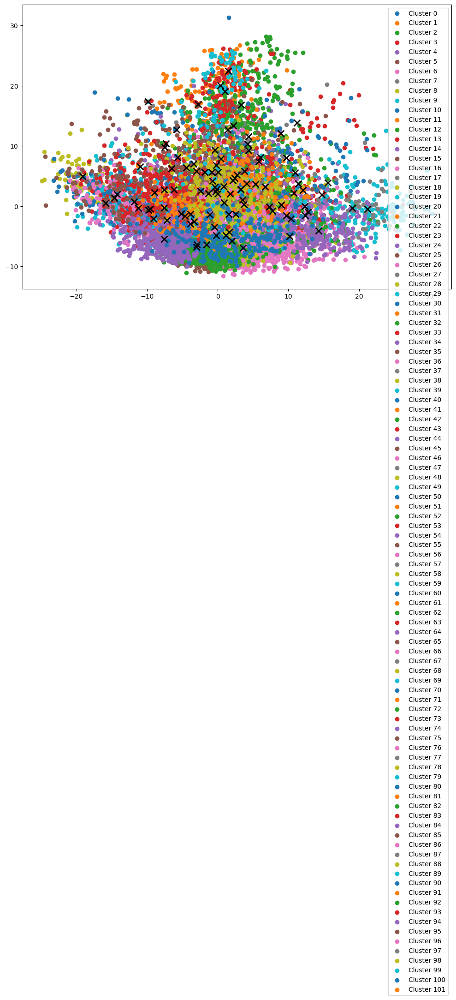

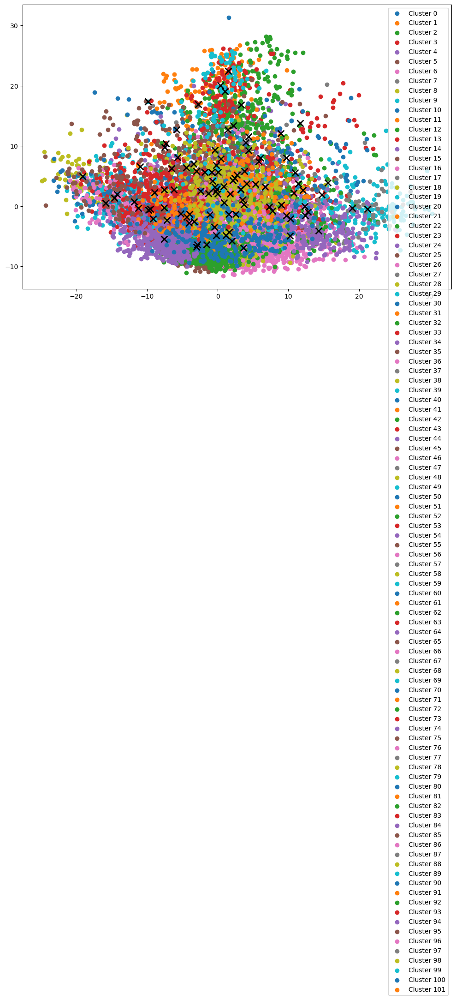

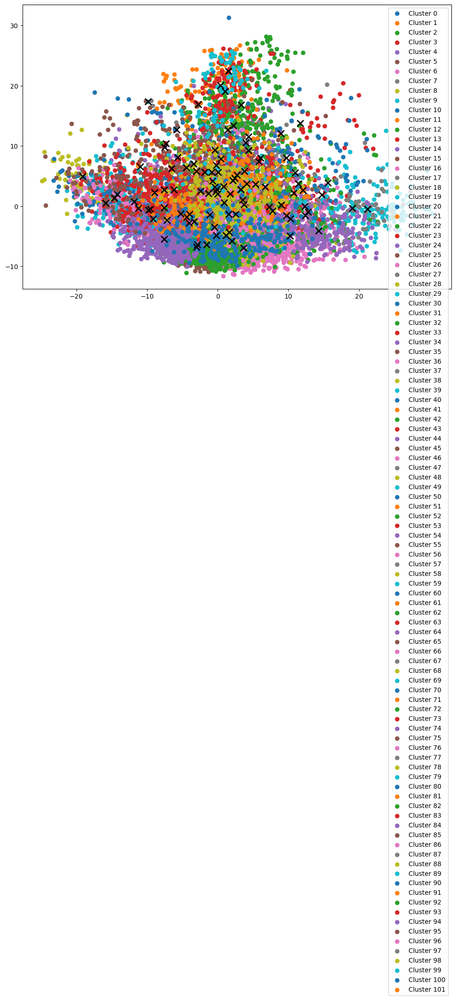

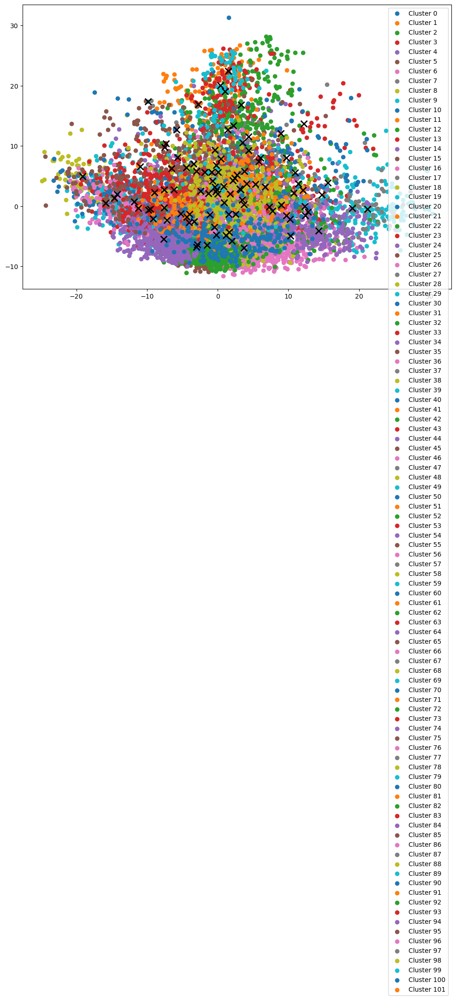

In [84]:
combined_hog_features = np.vstack((hog_features_xtrain, hog_features_test))
y_pred = classifier.predict(combined_hog_features)

## Make predictions on the test set

In [77]:
from scipy.stats import mode
import numpy as np

def calculate_kmeans_accuracy(true_labels, cluster_labels):
    # Map each cluster to the majority true label
    new_labels = np.zeros_like(cluster_labels)

    for cluster in np.unique(cluster_labels):
        mask = cluster_labels == cluster
        if np.any(mask):  # Check if the mask contains any True values
            # Find the most common true label in this cluster
            majority_label = mode(true_labels[mask]).mode
            # Handle scalar or array-like mode output
            majority_label = majority_label if np.ndim(majority_label) == 0 else majority_label[0]
            new_labels[mask] = majority_label

    # Calculate accuracy
    accuracy = np.mean(true_labels == new_labels)
    return accuracy


## Evaluate the classifier's performance


In [85]:
combined_y = np.hstack((y_train, y_test))
accuracy = calculate_kmeans_accuracy(combined_y.flatten(), y_pred)
print(f"Accuracy: {accuracy * 100:.2f}%")


Accuracy: 41.15%
